<a href="https://colab.research.google.com/github/olivia3110/JISEBI/blob/main/Simulation_paper_JEATS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

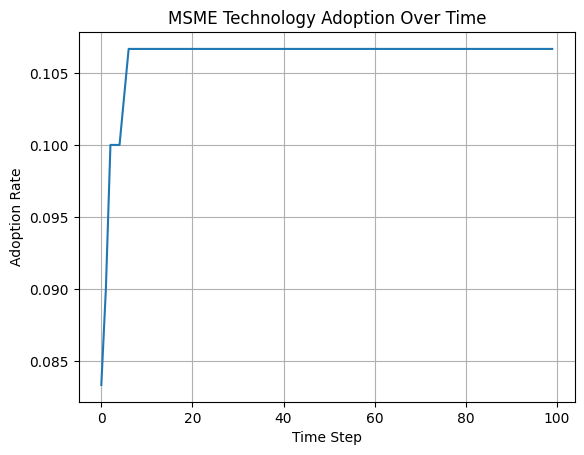

In [ ]:
# MSME ABM Simulation in Python (Google Colab Version)
# This is a simplified adaptation of the NetLogo model for execution in Python-based environments like Google Colab

import numpy as np
import random
import matplotlib.pyplot as plt

# Parameters
NUM_AGENTS = 300
RADIUS = 2
TIME_STEPS = 100
ALPHA = 0.1
BETA = 0.1
GAMMA = 0.1

# Agent initialization
class MSMEAgent:
    def __init__(self):
        self.adoption_status = 0
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.received_arguments = []
        self.position = np.random.rand(2) * 100
        self.peer_influence = 0.0

    def observe_peers(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            self.peer_influence = sum(a.adoption_status for a in neighbors) / len(neighbors)
        else:
            self.peer_influence = 0.0

    def exchange_arguments(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            partner = random.choice(neighbors)
            arg_type = random.choice(["pro", "con"])
            arg_strength = random.uniform(0, 1)
            self.received_arguments.append((arg_type, arg_strength))

    def update_perception(self):
        for arg in self.received_arguments:
            if arg[0] == "pro":
                self.perceived_benefit += ALPHA * arg[1]
            elif arg[0] == "con":
                self.perceived_benefit -= BETA * arg[1]
                self.perceived_risk += GAMMA * arg[1]
        self.received_arguments = []

    def make_decision(self):
        if self.adoption_status == 0:
            net_benefit = self.perceived_benefit - self.perceived_risk
            if net_benefit > self.decision_threshold:
                self.adoption_status = 1

# Initialize agents
agents = [MSMEAgent() for _ in range(NUM_AGENTS)]

# Simulation loop
adoption_rates = []
for t in range(TIME_STEPS):
    for agent in agents:
        agent.observe_peers(agents)
    for agent in agents:
        agent.exchange_arguments(agents)
    for agent in agents:
        agent.update_perception()
    for agent in agents:
        agent.make_decision()
    adoption_rate = sum(a.adoption_status for a in agents) / NUM_AGENTS
    adoption_rates.append(adoption_rate)

# Plot results
plt.plot(adoption_rates)
plt.xlabel('Time Step')
plt.ylabel('Adoption Rate')
plt.title('MSME Technology Adoption Over Time')
plt.grid(True)
plt.show()


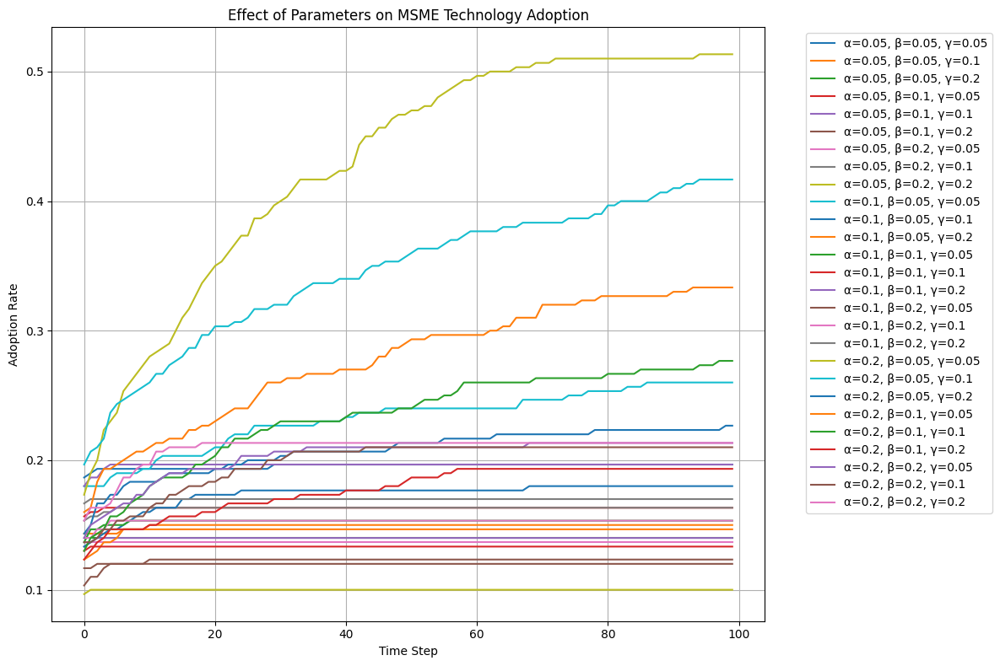

In [ ]:
# MSME ABM Simulation in Python (Google Colab Version)
# Revised to explore how different parameters influence technology adoption over time

import numpy as np
import random
import matplotlib.pyplot as plt

# Parameters
NUM_AGENTS = 300
RADIUS = 2
TIME_STEPS = 100
ALPHA = 0.1    # sensitivity to positive arguments
BETA = 0.1     # negative effect on benefit
GAMMA = 0.1    # increase in perceived risk due to negative arguments

# For sensitivity analysis
ALPHA_VALUES = [0.05, 0.1, 0.2]
BETA_VALUES = [0.05, 0.1, 0.2]
GAMMA_VALUES = [0.05, 0.1, 0.2]

class MSMEAgent:
    def __init__(self):
        self.adoption_status = 0
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.received_arguments = []
        self.position = np.random.rand(2) * 100
        self.peer_influence = 0.0

    def observe_peers(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            self.peer_influence = sum(a.adoption_status for a in neighbors) / len(neighbors)
        else:
            self.peer_influence = 0.0

    def exchange_arguments(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            partner = random.choice(neighbors)
            arg_type = random.choice(["pro", "con"])
            arg_strength = random.uniform(0, 1)
            self.received_arguments.append((arg_type, arg_strength))

    def update_perception(self, alpha, beta, gamma):
        for arg in self.received_arguments:
            if arg[0] == "pro":
                self.perceived_benefit += alpha * arg[1]
            elif arg[0] == "con":
                self.perceived_benefit -= beta * arg[1]
                self.perceived_risk += gamma * arg[1]
        self.received_arguments = []

    def make_decision(self):
        if self.adoption_status == 0:
            net_benefit = self.perceived_benefit - self.perceived_risk
            if net_benefit > self.decision_threshold:
                self.adoption_status = 1

# Simulation function

def run_simulation(alpha, beta, gamma):
    agents = [MSMEAgent() for _ in range(NUM_AGENTS)]
    adoption_rates = []
    for t in range(TIME_STEPS):
        for agent in agents:
            agent.observe_peers(agents)
        for agent in agents:
            agent.exchange_arguments(agents)
        for agent in agents:
            agent.update_perception(alpha, beta, gamma)
        for agent in agents:
            agent.make_decision()
        adoption_rate = sum(a.adoption_status for a in agents) / NUM_AGENTS
        adoption_rates.append(adoption_rate)
    return adoption_rates

# Run and compare different parameter combinations
results = {}
for alpha in ALPHA_VALUES:
    for beta in BETA_VALUES:
        for gamma in GAMMA_VALUES:
            label = f"α={alpha}, β={beta}, γ={gamma}"
            results[label] = run_simulation(alpha, beta, gamma)

# Plotting results
plt.figure(figsize=(12, 8))
for label, rates in results.items():
    plt.plot(rates, label=label)
plt.xlabel('Time Step')
plt.ylabel('Adoption Rate')
plt.title('Effect of Parameters on MSME Technology Adoption')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
# MSME ABM Simulation in Python (Google Colab Version)
# Interactive version with step-by-step output and session saving

import numpy as np
import random
import matplotlib.pyplot as plt
from ipywidgets import interact, FloatSlider
import ipywidgets as widgets
import pandas as pd

# Parameters
NUM_AGENTS = 300  # Total number of agents (MSMEs)
RADIUS = 2        # Radius of interaction for peer observation
TIME_STEPS = 100  # Total number of simulation steps

# Define the MSME agent class
class MSMEAgent:
    def __init__(self):
        # Initialize agent properties
        self.adoption_status = 0  # 0 = not adopted, 1 = adopted
        self.perceived_benefit = random.uniform(0, 1)  # subjective perceived benefit
        self.perceived_risk = random.uniform(0, 1)     # perceived risk
        self.attitude = random.uniform(0, 1)           # openness to innovation
        self.decision_threshold = random.uniform(0.2, 0.8)  # threshold for adoption
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.received_arguments = []                   # list to store received arguments
        self.position = np.random.rand(2) * 100        # spatial position in 2D space
        self.peer_influence = 0.0                      # influence from peers

    def observe_peers(self, agents):
        # Determine the proportion of neighbors who have adopted
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            self.peer_influence = sum(a.adoption_status for a in neighbors) / len(neighbors)
        else:
            self.peer_influence = 0.0

    def exchange_arguments(self, agents):
        # Exchange arguments with a random neighbor
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            partner = random.choice(neighbors)
            arg_type = random.choice(["pro", "con"])
            arg_strength = random.uniform(0, 1)
            self.received_arguments.append((arg_type, arg_strength))

    def update_perception(self, alpha, beta, gamma):
        # Update perceived benefit and risk based on received arguments
        for arg in self.received_arguments:
            if arg[0] == "pro":
                self.perceived_benefit += alpha * arg[1]
            elif arg[0] == "con":
                self.perceived_benefit -= beta * arg[1]
                self.perceived_risk += gamma * arg[1]
        self.received_arguments = []  # clear arguments after processing

    def make_decision(self):
        # Adopt if perceived benefit minus risk exceeds the threshold
        if self.adoption_status == 0:
            net_benefit = self.perceived_benefit - self.perceived_risk
            if net_benefit > self.decision_threshold:
                self.adoption_status = 1

# Simulation function

def run_simulation(alpha, beta, gamma):
    agents = [MSMEAgent() for _ in range(NUM_AGENTS)]
    adoption_rates = []
    step_data = []  # to store state at each step

    for t in range(TIME_STEPS):
        print(f"--- Time Step {t+1} ---")
        for agent in agents:
            agent.observe_peers(agents)
        for agent in agents:
            agent.exchange_arguments(agents)
        for agent in agents:
            agent.update_perception(alpha, beta, gamma)
        for agent in agents:
            agent.make_decision()

        adoption_rate = sum(a.adoption_status for a in agents) / NUM_AGENTS
        adoption_rates.append(adoption_rate)

        # Collect data for export
        for i, agent in enumerate(agents):
            step_data.append({
                "time": t,
                "agent_id": i,
                "adoption_status": agent.adoption_status,
                "perceived_benefit": agent.perceived_benefit,
                "perceived_risk": agent.perceived_risk,
                "decision_threshold": agent.decision_threshold,
                "peer_influence": agent.peer_influence,
                "agent_type": agent.agent_type
            })

        print(f"Adoption Rate: {adoption_rate:.2f}")

    # Convert data to DataFrame and save as CSV
    df = pd.DataFrame(step_data)
    df.to_csv("msme_abm_simulation_log.csv", index=False)
    print("Simulation log saved to msme_abm_simulation_log.csv")

    # Plot the adoption rate over time
    plt.figure(figsize=(10, 6))
    plt.plot(adoption_rates)
    plt.xlabel('Time Step')
    plt.ylabel('Adoption Rate')
    plt.title(f"Adoption Rate Over Time\nα={alpha}, β={beta}, γ={gamma}")
    plt.grid(True)
    plt.show()

# Interactive sliders for user input
interact(run_simulation,
         alpha=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Alpha (α)'),
         beta=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Beta (β)'),
         gamma=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Gamma (γ)'))


interactive(children=(FloatSlider(value=0.1, description='Alpha (α)', max=0.5, min=0.01, step=0.01), FloatSlid…

<function __main__.run_simulation(alpha, beta, gamma)>

In [ ]:
# MSME ABM Simulation in Python (Google Colab Version)
# Interactive version with step-by-step output, CSV export, and animation

import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from ipywidgets import interact, FloatSlider
import ipywidgets as widgets
import pandas as pd

# Parameters
NUM_AGENTS = 300
RADIUS = 2
TIME_STEPS = 100

# MSME Agent class
class MSMEAgent:
    def __init__(self):
        self.adoption_status = 0
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.received_arguments = []
        self.position = np.random.rand(2) * 100
        self.peer_influence = 0.0

    def observe_peers(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            self.peer_influence = sum(a.adoption_status for a in neighbors) / len(neighbors)
        else:
            self.peer_influence = 0.0

    def exchange_arguments(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            partner = random.choice(neighbors)
            arg_type = random.choice(["pro", "con"])
            arg_strength = random.uniform(0, 1)
            self.received_arguments.append((arg_type, arg_strength))

    def update_perception(self, alpha, beta, gamma):
        for arg in self.received_arguments:
            if arg[0] == "pro":
                self.perceived_benefit += alpha * arg[1]
            elif arg[0] == "con":
                self.perceived_benefit -= beta * arg[1]
                self.perceived_risk += gamma * arg[1]
        self.received_arguments = []

    def make_decision(self):
        if self.adoption_status == 0:
            net_benefit = self.perceived_benefit - self.perceived_risk
            if net_benefit > self.decision_threshold:
                self.adoption_status = 1

# Simulation function with animation support

def run_simulation(alpha, beta, gamma):
    agents = [MSMEAgent() for _ in range(NUM_AGENTS)]
    step_data = []
    snapshots = []  # Store adoption status at each step for animation

    for t in range(TIME_STEPS):
        print(f"--- Time Step {t+1} ---")
        for agent in agents:
            agent.observe_peers(agents)
        for agent in agents:
            agent.exchange_arguments(agents)
        for agent in agents:
            agent.update_perception(alpha, beta, gamma)
        for agent in agents:
            agent.make_decision()

        snapshot = [(agent.position[0], agent.position[1], agent.adoption_status) for agent in agents]
        snapshots.append(snapshot)

        for i, agent in enumerate(agents):
            step_data.append({
                "time": t,
                "agent_id": i,
                "adoption_status": agent.adoption_status,
                "perceived_benefit": agent.perceived_benefit,
                "perceived_risk": agent.perceived_risk,
                "decision_threshold": agent.decision_threshold,
                "peer_influence": agent.peer_influence,
                "agent_type": agent.agent_type
            })

    df = pd.DataFrame(step_data)
    df.to_csv("msme_abm_simulation_log.csv", index=False)
    print("Simulation log saved to msme_abm_simulation_log.csv")

    # Animate agent adoption over time
    fig, ax = plt.subplots(figsize=(6, 6))
    scat = ax.scatter([], [], s=20)
    ax.set_xlim(0, 100)
    ax.set_ylim(0, 100)
    ax.set_title("MSME Technology Adoption Animation")

    def update(frame):
        data = snapshots[frame]
        x = [p[0] for p in data]
        y = [p[1] for p in data]
        colors = ['green' if p[2] == 1 else 'red' for p in data]
        scat.set_offsets(np.c_[x, y])
        scat.set_color(colors)
        ax.set_title(f"Step {frame+1}")
        return scat,

    ani = animation.FuncAnimation(fig, update, frames=len(snapshots), interval=200, blit=True)
    plt.show()

# Interactive widgets
interact(run_simulation,
         alpha=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Alpha (α)'),
         beta=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Beta (β)'),
         gamma=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Gamma (γ)'))


interactive(children=(FloatSlider(value=0.1, description='Alpha (α)', max=0.5, min=0.01, step=0.01), FloatSlid…

<function __main__.run_simulation(alpha, beta, gamma)>

In [ ]:
# MSME ABM Simulation in Python (Google Colab Version)
# Interactive version with step-by-step output, CSV export, and HTML animation for Google Colab

import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.animation import PillowWriter
from IPython.display import HTML
from ipywidgets import interact, FloatSlider
import ipywidgets as widgets
import pandas as pd

# Parameters
NUM_AGENTS = 300
RADIUS = 2
TIME_STEPS = 100

# MSME Agent class
class MSMEAgent:
    def __init__(self):
        self.adoption_status = 0
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.received_arguments = []
        self.position = np.random.rand(2) * 100
        self.peer_influence = 0.0

    def observe_peers(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            self.peer_influence = sum(a.adoption_status for a in neighbors) / len(neighbors)
        else:
            self.peer_influence = 0.0

    def exchange_arguments(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            partner = random.choice(neighbors)
            arg_type = random.choice(["pro", "con"])
            arg_strength = random.uniform(0, 1)
            self.received_arguments.append((arg_type, arg_strength))

    def update_perception(self, alpha, beta, gamma):
        for arg in self.received_arguments:
            if arg[0] == "pro":
                self.perceived_benefit += alpha * arg[1]
            elif arg[0] == "con":
                self.perceived_benefit -= beta * arg[1]
                self.perceived_risk += gamma * arg[1]
        self.received_arguments = []

    def make_decision(self):
        if self.adoption_status == 0:
            net_benefit = self.perceived_benefit - self.perceived_risk
            if net_benefit > self.decision_threshold:
                self.adoption_status = 1

# Simulation function with HTML animation support for Google Colab

def run_simulation(alpha, beta, gamma):
    agents = [MSMEAgent() for _ in range(NUM_AGENTS)]
    step_data = []
    snapshots = []  # Store adoption status at each step for animation

    for t in range(TIME_STEPS):
        for agent in agents:
            agent.observe_peers(agents)
        for agent in agents:
            agent.exchange_arguments(agents)
        for agent in agents:
            agent.update_perception(alpha, beta, gamma)
        for agent in agents:
            agent.make_decision()

        snapshot = [(agent.position[0], agent.position[1], agent.adoption_status) for agent in agents]
        snapshots.append(snapshot)

        for i, agent in enumerate(agents):
            step_data.append({
                "time": t,
                "agent_id": i,
                "adoption_status": agent.adoption_status,
                "perceived_benefit": agent.perceived_benefit,
                "perceived_risk": agent.perceived_risk,
                "decision_threshold": agent.decision_threshold,
                "peer_influence": agent.peer_influence,
                "agent_type": agent.agent_type
            })

    df = pd.DataFrame(step_data)
    df.to_csv("msme_abm_simulation_log.csv", index=False)
    print("Simulation log saved to msme_abm_simulation_log.csv")

    # Animate agent adoption over time
    fig, ax = plt.subplots(figsize=(6, 6))
    scat = ax.scatter([], [], s=20)
    ax.set_xlim(0, 100)
    ax.set_ylim(0, 100)
    ax.set_title("MSME Technology Adoption Animation")

    def update(frame):
        data = snapshots[frame]
        x = [p[0] for p in data]
        y = [p[1] for p in data]
        colors = ['green' if p[2] == 1 else 'red' for p in data]
        scat.set_offsets(np.c_[x, y])
        scat.set_color(colors)
        ax.set_title(f"Step {frame+1}")
        return scat,

    ani = animation.FuncAnimation(fig, update, frames=len(snapshots), interval=200, blit=True)
    html_anim = HTML(ani.to_jshtml())
    plt.close(fig)
    return html_anim

# Interactive widgets
interact(run_simulation,
         alpha=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Alpha (α)'),
         beta=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Beta (β)'),
         gamma=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Gamma (γ)'))

interactive(children=(FloatSlider(value=0.1, description='Alpha (α)', max=0.5, min=0.01, step=0.01), FloatSlid…

<function __main__.run_simulation(alpha, beta, gamma)>

In [ ]:
# MSME ABM Simulation in Python (Google Colab Version)
# Interactive version with step-by-step output, CSV export, and JS-based animation for Google Colab

import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display
from ipywidgets import interact, FloatSlider
import ipywidgets as widgets
import pandas as pd

# Parameters
NUM_AGENTS = 300
RADIUS = 2
TIME_STEPS = 100

# MSME Agent class
class MSMEAgent:
    def __init__(self):
        self.adoption_status = 0
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.received_arguments = []
        self.position = np.random.rand(2) * 100
        self.peer_influence = 0.0

    def observe_peers(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            self.peer_influence = sum(a.adoption_status for a in neighbors) / len(neighbors)
        else:
            self.peer_influence = 0.0

    def exchange_arguments(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            partner = random.choice(neighbors)
            arg_type = random.choice(["pro", "con"])
            arg_strength = random.uniform(0, 1)
            self.received_arguments.append((arg_type, arg_strength))

    def update_perception(self, alpha, beta, gamma):
        for arg in self.received_arguments:
            if arg[0] == "pro":
                self.perceived_benefit += alpha * arg[1]
            elif arg[0] == "con":
                self.perceived_benefit -= beta * arg[1]
                self.perceived_risk += gamma * arg[1]
        self.received_arguments = []

    def make_decision(self):
        if self.adoption_status == 0:
            net_benefit = self.perceived_benefit - self.perceived_risk
            if net_benefit > self.decision_threshold:
                self.adoption_status = 1

# Simulation function with HTML animation for Colab

def run_simulation(alpha, beta, gamma):
    agents = [MSMEAgent() for _ in range(NUM_AGENTS)]
    step_data = []
    snapshots = []  # Store adoption status at each step for animation

    for t in range(TIME_STEPS):
        for agent in agents:
            agent.observe_peers(agents)
        for agent in agents:
            agent.exchange_arguments(agents)
        for agent in agents:
            agent.update_perception(alpha, beta, gamma)
        for agent in agents:
            agent.make_decision()

        snapshot = [(agent.position[0], agent.position[1], agent.adoption_status) for agent in agents]
        snapshots.append(snapshot)

        for i, agent in enumerate(agents):
            step_data.append({
                "time": t,
                "agent_id": i,
                "adoption_status": agent.adoption_status,
                "perceived_benefit": agent.perceived_benefit,
                "perceived_risk": agent.perceived_risk,
                "decision_threshold": agent.decision_threshold,
                "peer_influence": agent.peer_influence,
                "agent_type": agent.agent_type
            })

    # Export simulation log
    df = pd.DataFrame(step_data)
    df.to_csv("msme_abm_simulation_log.csv", index=False)
    print("Simulation log saved to msme_abm_simulation_log.csv")

    # Create animation
    fig, ax = plt.subplots(figsize=(6, 6))
    scat = ax.scatter([], [], s=20)
    ax.set_xlim(0, 100)
    ax.set_ylim(0, 100)
    ax.set_title("MSME Technology Adoption Animation")

    def update(frame):
        data = snapshots[frame]
        x = [p[0] for p in data]
        y = [p[1] for p in data]
        colors = ['green' if p[2] == 1 else 'red' for p in data]
        scat.set_offsets(np.c_[x, y])
        scat.set_color(colors)
        ax.set_title(f"Step {frame+1}")
        return scat,

    ani = animation.FuncAnimation(fig, update, frames=len(snapshots), interval=200)
    plt.close(fig)
    display(HTML(ani.to_jshtml()))

# Interactive widget for parameter tuning
interact(run_simulation,
         alpha=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Alpha (α)'),
         beta=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Beta (β)'),
         gamma=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Gamma (γ)'))

interactive(children=(FloatSlider(value=0.1, description='Alpha (α)', max=0.5, min=0.01, step=0.01), FloatSlid…

<function __main__.run_simulation(alpha, beta, gamma)>

In [ ]:
# MSME ABM Simulation in Python (Google Colab Version)
# With attitude dynamics, animation, and CSV logging

import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display
from ipywidgets import interact, FloatSlider
import pandas as pd

# Parameters
NUM_AGENTS = 300
RADIUS = 2
TIME_STEPS = 100

# MSME Agent class
class MSMEAgent:
    def __init__(self):
        self.adoption_status = 0
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.received_arguments = []
        self.position = np.random.rand(2) * 100
        self.peer_influence = 0.0

        # New attributes for cognitive flexibility
        self.volatility = random.uniform(0.1, 0.5)  # susceptibility to change
        self.resilience = random.uniform(0.1, 0.9)  # resistance to change

    def observe_peers(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            self.peer_influence = sum(a.adoption_status for a in neighbors) / len(neighbors)
        else:
            self.peer_influence = 0.0

    def exchange_arguments(self, agents):
        neighbors = [a for a in agents if np.linalg.norm(self.position - a.position) <= RADIUS and a != self]
        if neighbors:
            partner = random.choice(neighbors)
            arg_type = random.choice(["pro", "con"])
            arg_strength = random.uniform(0, 1)
            self.received_arguments.append((arg_type, arg_strength))

    def update_perception(self, alpha, beta, gamma):
        for arg in self.received_arguments:
            if arg[0] == "pro":
                self.perceived_benefit += alpha * arg[1]
            elif arg[0] == "con":
                self.perceived_benefit -= beta * arg[1]
                self.perceived_risk += gamma * arg[1]
        self.received_arguments = []

    def adjust_attitude(self, env_shock):
        # Adjust agent's attitude based on environmental shock
        influence = self.volatility * (1 - self.resilience) * env_shock
        self.attitude = min(max(self.attitude + influence, 0), 1)

    def make_decision(self):
        if self.adoption_status == 0:
            net_benefit = self.perceived_benefit - self.perceived_risk + (0.2 * self.attitude)
            if net_benefit > self.decision_threshold:
                self.adoption_status = 1

# Simulation function
def run_simulation(alpha, beta, gamma):
    agents = [MSMEAgent() for _ in range(NUM_AGENTS)]
    step_data = []
    snapshots = []

    for t in range(TIME_STEPS):
        print(f"--- Time Step {t+1} ---")
        env_shock = random.uniform(-0.3, 0.3)  # external stimulus for this time step

        for agent in agents:
            agent.observe_peers(agents)
        for agent in agents:
            agent.exchange_arguments(agents)
        for agent in agents:
            agent.update_perception(alpha, beta, gamma)
            agent.adjust_attitude(env_shock)  # dynamically adjust attitude
        for agent in agents:
            agent.make_decision()

        snapshot = [(agent.position[0], agent.position[1], agent.adoption_status) for agent in agents]
        snapshots.append(snapshot)

        for i, agent in enumerate(agents):
            step_data.append({
                "time": t,
                "agent_id": i,
                "adoption_status": agent.adoption_status,
                "perceived_benefit": agent.perceived_benefit,
                "perceived_risk": agent.perceived_risk,
                "decision_threshold": agent.decision_threshold,
                "peer_influence": agent.peer_influence,
                "attitude": agent.attitude,
                "volatility": agent.volatility,
                "resilience": agent.resilience,
                "agent_type": agent.agent_type
            })

    # Save CSV log
    df = pd.DataFrame(step_data)
    df.to_csv("msme_abm_simulation_log.csv", index=False)
    print("Simulation log saved to msme_abm_simulation_log.csv")

    # Animation
    fig, ax = plt.subplots(figsize=(6, 6))
    scat = ax.scatter([], [], s=20)
    ax.set_xlim(0, 100)
    ax.set_ylim(0, 100)

    def update(frame):
        data = snapshots[frame]
        x = [p[0] for p in data]
        y = [p[1] for p in data]
        colors = ['green' if p[2] == 1 else 'red' for p in data]
        scat.set_offsets(np.c_[x, y])
        scat.set_color(colors)
        ax.set_title(f"Step {frame+1}")
        return scat,

    ani = animation.FuncAnimation(fig, update, frames=len(snapshots), interval=200)
    plt.close(fig)
    return HTML(ani.to_jshtml())

# Run with interactive slider
interact(run_simulation,
         alpha=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Alpha (α)'),
         beta=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Beta (β)'),
         gamma=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Gamma (γ)'))


interactive(children=(FloatSlider(value=0.1, description='Alpha (α)', max=0.5, min=0.01, step=0.01), FloatSlid…

<function __main__.run_simulation(alpha, beta, gamma)>

In [ ]:
# MSME ABM Simulation with People Icons, Zone Influence & Movement

import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.patches import Rectangle
from IPython.display import HTML
from ipywidgets import interact, FloatSlider, IntSlider

# MSME Agent class
class MSMEAgent:
    def __init__(self, zone_width):
        self.adoption_status = 0
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.position = np.random.rand(2) * 100
        self.peer_influence = 0.0
        self.volatility = random.uniform(0.1, 0.5)
        self.resilience = random.uniform(0.1, 0.9)
        self.zone_width = zone_width

    def move(self):
        # Random walk within bounds
        self.position += np.random.uniform(-2, 2, 2)
        self.position = np.clip(self.position, 0, 100)

    def get_zone_env_shock(self):
        if self.position[0] < self.zone_width:           # Zone 1: discourage adoption
            return -0.3
        elif self.position[0] > (100 - self.zone_width): # Zone 3: encourage adoption
            return +0.3
        else:                                            # Zone 2: neutral
            return random.uniform(-0.1, 0.1)

    def update_attitude(self, env_shock):
        influence = self.volatility * (1 - self.resilience) * env_shock
        self.attitude = min(max(self.attitude + influence, 0), 1)

    def decide(self, alpha, beta, gamma):
        net_benefit = self.perceived_benefit - self.perceived_risk + 0.2 * self.attitude
        if self.adoption_status == 0 and net_benefit > self.decision_threshold:
            self.adoption_status = 1
        elif self.adoption_status == 1 and net_benefit < self.decision_threshold * 0.7:
            self.adoption_status = 0  # reversal in perception

# Run simulation
def run_simulation(alpha, beta, gamma, num_agents, zone_width):
    agents = [MSMEAgent(zone_width) for _ in range(num_agents)]
    steps = 100
    snapshots = []

    for t in range(steps):
        for agent in agents:
            agent.move()
            shock = agent.get_zone_env_shock()
            agent.update_attitude(shock)
            # Argument simulation simplified: one positive/negative signal per step
            if random.random() < 0.5:
                agent.perceived_benefit += alpha * random.uniform(0, 1)
            else:
                agent.perceived_benefit -= beta * random.uniform(0, 1)
                agent.perceived_risk += gamma * random.uniform(0, 1)
            agent.decide(alpha, beta, gamma)

        snapshot = [(a.position[0], a.position[1], a.adoption_status, a.attitude) for a in agents]
        snapshots.append(snapshot)

    # Setup animation
    fig, ax = plt.subplots(figsize=(7, 7))
    ax.set_xlim(0, 100)
    ax.set_ylim(0, 100)
    ax.set_title("MSME Technology Adoption Simulation")
    ax.set_xlabel("Environment Zones")
    ax.set_ylabel("Agent Position")
    text_objs = []

    # Draw background zones
    ax.add_patch(Rectangle((0, 0), zone_width, 100, color='lightcoral', alpha=0.2, label='Reject Zone'))
    ax.add_patch(Rectangle((zone_width, 0), 100 - 2*zone_width, 100, color='lightblue', alpha=0.2, label='Neutral Zone'))
    ax.add_patch(Rectangle((100 - zone_width, 0), zone_width, 100, color='lightgreen', alpha=0.2, label='Adoption Zone'))

    def update(frame):
        nonlocal text_objs
        for txt in text_objs:
            txt.remove()
        text_objs = []
        data = snapshots[frame]
        for x, y, adopted, attitude in data:
            color = 'green' if adopted == 1 else ('orange' if attitude > 0.6 else 'red')
            txt = ax.text(x, y, '👤', fontsize=12, ha='center', va='center', color=color)
            text_objs.append(txt)
        ax.set_title(f"Step {frame + 1}")
        return text_objs

    ani = animation.FuncAnimation(fig, update, frames=len(snapshots), interval=300)
    plt.close()
    return HTML(ani.to_jshtml())

# Interactive sliders
interact(run_simulation,
         alpha=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Alpha (α)'),
         beta=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Beta (β)'),
         gamma=FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Gamma (γ)'),
         num_agents=IntSlider(value=100, min=20, max=500, step=10, description='Agents'),
         zone_width=IntSlider(value=20, min=10, max=40, step=5, description='Zone Width'))


interactive(children=(FloatSlider(value=0.1, description='Alpha (α)', max=0.5, min=0.01, step=0.01), FloatSlid…

<function __main__.run_simulation(alpha, beta, gamma, num_agents, zone_width)>

In [ ]:
import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.patches import Rectangle
from IPython.display import HTML, display
import ipywidgets as widgets

# MSME Agent class with behavior and zone-aware decision-making
class MSMEAgent:
    def __init__(self, zone_width, initially_adopted):
        self.adoption_status = 1 if initially_adopted else 0
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.position = np.random.rand(2) * 100
        self.peer_influence = 0.0
        self.volatility = random.uniform(0.1, 0.5)
        self.resilience = random.uniform(0.1, 0.9)
        self.zone_width = zone_width

    def move(self):
        self.position += np.random.uniform(-2, 2, 2)
        self.position = np.clip(self.position, 0, 100)

    def get_zone_env_shock(self):
        if self.position[0] < self.zone_width:
            return -0.3
        elif self.position[0] > (100 - self.zone_width):
            return +0.3
        else:
            return random.uniform(-0.1, 0.1)

    def update_attitude(self, env_shock):
        influence = self.volatility * (1 - self.resilience) * env_shock
        self.attitude = min(max(self.attitude + influence, 0), 1)

    def decide(self, alpha, beta, gamma):
        net_benefit = self.perceived_benefit - self.perceived_risk + 0.2 * self.attitude
        if self.adoption_status == 0 and net_benefit > self.decision_threshold:
            self.adoption_status = 1
        elif self.adoption_status == 1 and net_benefit < self.decision_threshold * 0.7:
            self.adoption_status = 0

# Widgets
alpha_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Alpha (α)')
beta_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Beta (β)')
gamma_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Gamma (γ)')
num_agents_slider = widgets.IntSlider(value=100, min=20, max=500, step=10, description='Agents')
zone_width_slider = widgets.IntSlider(value=20, min=10, max=40, step=5, description='Zone Width')
initial_adoption_slider = widgets.IntSlider(value=20, min=0, max=100, step=5, description='% Adopted')
run_button = widgets.Button(description="Run Simulation")
output = widgets.Output()

def run_simulation(b):
    output.clear_output()
    with output:
        alpha = alpha_slider.value
        beta = beta_slider.value
        gamma = gamma_slider.value
        num_agents = num_agents_slider.value
        zone_width = zone_width_slider.value
        initial_adoption_percent = initial_adoption_slider.value

        steps = 50
        agents = []
        for i in range(num_agents):
            adopted = i < int(initial_adoption_percent / 100 * num_agents)
            agents.append(MSMEAgent(zone_width, adopted))
        snapshots = []
        adoption_over_time = []

        for t in range(steps):
            for agent in agents:
                agent.move()
                shock = agent.get_zone_env_shock()
                agent.update_attitude(shock)
                if random.random() < 0.5:
                    agent.perceived_benefit += alpha * random.uniform(0, 1)
                else:
                    agent.perceived_benefit -= beta * random.uniform(0, 1)
                    agent.perceived_risk += gamma * random.uniform(0, 1)
                agent.decide(alpha, beta, gamma)

            snapshot = [(a.position[0], a.position[1], a.adoption_status, a.attitude) for a in agents]
            snapshots.append(snapshot)
            adoption_over_time.append(sum([a.adoption_status for a in agents]) / num_agents)

        # Set up animation
        fig, ax = plt.subplots(figsize=(7, 7))
        ax.set_xlim(0, 100)
        ax.set_ylim(0, 100)
        text_objs = []

        ax.add_patch(Rectangle((0, 0), zone_width, 100, color='lightcoral', alpha=0.2))
        ax.add_patch(Rectangle((zone_width, 0), 100 - 2 * zone_width, 100, color='lightblue', alpha=0.2))
        ax.add_patch(Rectangle((100 - zone_width, 0), zone_width, 100, color='lightgreen', alpha=0.2))

        def update(frame):
            nonlocal text_objs
            for txt in text_objs:
                txt.remove()
            text_objs = []
            data = snapshots[frame]
            for x, y, adopted, attitude in data:
                color = 'green' if adopted == 1 else ('orange' if attitude > 0.6 else 'red')
                txt = ax.text(x, y, '👤', fontsize=12, ha='center', va='center', color=color)
                text_objs.append(txt)
            ax.set_title(f"Year: {2025 + frame}")
            return text_objs

        ani = animation.FuncAnimation(fig, update, frames=len(snapshots), interval=300)
        display(HTML(ani.to_jshtml()))

        # Plot adoption rate over time
        plt.figure(figsize=(8, 4))
        plt.plot(range(2025, 2025 + steps), adoption_over_time, marker='o')
        plt.xlabel("Year")
        plt.ylabel("Adoption Rate")
        plt.title("Adoption Trend Over Time")
        plt.grid(True)
        plt.show()

# Button event
run_button.on_click(run_simulation)

# Display UI
display(widgets.VBox([
    alpha_slider, beta_slider, gamma_slider,
    num_agents_slider, zone_width_slider, initial_adoption_slider,
    run_button, output
]))


In [ ]:
import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.patches import Rectangle
from IPython.display import HTML, display
import ipywidgets as widgets

# MSME Agent class
class MSMEAgent:
    def __init__(self, zone_width, initially_adopted):
        self.adoption_status = 1 if initially_adopted else 0
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.position = np.random.rand(2) * 100
        self.peer_influence = 0.0
        self.volatility = random.uniform(0.1, 0.5)
        self.resilience = random.uniform(0.1, 0.9)
        self.zone_width = zone_width

    def move(self):
        self.position += np.random.uniform(-2, 2, 2)
        self.position = np.clip(self.position, 0, 100)

    def get_zone_env_shock(self):
        if self.position[0] < self.zone_width:
            return -0.3
        elif self.position[0] > (100 - self.zone_width):
            return +0.3
        else:
            return random.uniform(-0.1, 0.1)

    def update_attitude(self, env_shock):
        influence = self.volatility * (1 - self.resilience) * env_shock
        self.attitude = min(max(self.attitude + influence, 0), 1)

    def decide(self, alpha, beta, gamma):
        net_benefit = self.perceived_benefit - self.perceived_risk + 0.2 * self.attitude
        if self.adoption_status == 0 and net_benefit > self.decision_threshold:
            self.adoption_status = 1
        elif self.adoption_status == 1 and net_benefit < self.decision_threshold * 0.7:
            self.adoption_status = 0

# Widgets
alpha_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Alpha (α)')
beta_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Beta (β)')
gamma_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Gamma (γ)')
num_agents_slider = widgets.IntSlider(value=100, min=20, max=500, step=10, description='Agents')
zone_width_slider = widgets.IntSlider(value=20, min=10, max=40, step=5, description='Zone Width')
initial_adoption_slider = widgets.IntSlider(value=20, min=0, max=100, step=5, description='% Adopted')
run_button = widgets.Button(description="Run Simulation")
output = widgets.Output()

def run_simulation(b):
    output.clear_output()
    with output:
        alpha = alpha_slider.value
        beta = beta_slider.value
        gamma = gamma_slider.value
        num_agents = num_agents_slider.value
        zone_width = zone_width_slider.value
        initial_adoption_percent = initial_adoption_slider.value

        steps = 50
        agents = []
        for i in range(num_agents):
            adopted = i < int(initial_adoption_percent / 100 * num_agents)
            agents.append(MSMEAgent(zone_width, adopted))
        snapshots = []
        adoption_over_time = []

        for t in range(steps):
            for agent in agents:
                agent.move()
                shock = agent.get_zone_env_shock()
                agent.update_attitude(shock)
                if random.random() < 0.5:
                    agent.perceived_benefit += alpha * random.uniform(0, 1)
                else:
                    agent.perceived_benefit -= beta * random.uniform(0, 1)
                    agent.perceived_risk += gamma * random.uniform(0, 1)
                agent.decide(alpha, beta, gamma)

            snapshot = [(a.position[0], a.position[1], a.adoption_status, a.attitude) for a in agents]
            snapshots.append(snapshot)
            adoption_over_time.append(sum([a.adoption_status for a in agents]) / num_agents)

        # Set up animation with dynamic plot
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 10))
        ax1.set_xlim(0, 100)
        ax1.set_ylim(0, 100)
        ax2.set_xlim(2025, 2025 + steps)
        ax2.set_ylim(0, 1.05)

        ax1.add_patch(Rectangle((0, 0), zone_width, 100, color='lightcoral', alpha=0.2))
        ax1.add_patch(Rectangle((zone_width, 0), 100 - 2 * zone_width, 100, color='lightblue', alpha=0.2))
        ax1.add_patch(Rectangle((100 - zone_width, 0), zone_width, 100, color='lightgreen', alpha=0.2))

        text_objs = []
        line_adoption, = ax2.plot([], [], color='blue', marker='o')
        ax2.set_title("Grafik Adopsi Teknologi")
        ax2.set_xlabel("Tahun")
        ax2.set_ylabel("Tingkat Adopsi")

        def update(frame):
            nonlocal text_objs
            for txt in text_objs:
                txt.remove()
            text_objs = []
            data = snapshots[frame]
            for x, y, adopted, attitude in data:
                color = 'green' if adopted == 1 else ('orange' if attitude > 0.6 else 'red')
                txt = ax1.text(x, y, '👤', fontsize=12, ha='center', va='center', color=color)
                text_objs.append(txt)
            ax1.set_title(f"Tahun ke-{frame + 1}")
            x = list(range(2025, 2025 + frame + 1))
            y = adoption_over_time[:frame + 1]
            line_adoption.set_data(x, y)
            return text_objs + [line_adoption]

        ani = animation.FuncAnimation(fig, update, frames=len(snapshots), interval=300, blit=False)
        plt.close()
        display(HTML(ani.to_jshtml()))

run_button.on_click(run_simulation)

display(widgets.VBox([
    alpha_slider, beta_slider, gamma_slider,
    num_agents_slider, zone_width_slider, initial_adoption_slider,
    run_button, output
]))

In [ ]:
# INSTALLATION (run once if needed)
!pip install ipywidgets --quiet

# ===========================
# MSME AGENT-BASED SIMULATION
# ===========================

import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.patches import Rectangle
from IPython.display import HTML, display
import ipywidgets as widgets
import pandas as pd

# MSME Agent Class
class MSMEAgent:
    def __init__(self, zone_width, initially_adopted):
        self.adoption_status = 1 if initially_adopted else 0
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.position = np.random.rand(2) * 100
        self.peer_influence = 0.0
        self.volatility = random.uniform(0.1, 0.5)
        self.resilience = random.uniform(0.1, 0.9)
        self.zone_width = zone_width

    def move(self):
        self.position += np.random.uniform(-2, 2, 2)
        self.position = np.clip(self.position, 0, 100)

    def get_zone_env_shock(self):
        if self.position[0] < self.zone_width:
            return -0.3
        elif self.position[0] > (100 - self.zone_width):
            return +0.3
        else:
            return random.uniform(-0.1, 0.1)

    def update_attitude(self, env_shock):
        influence = self.volatility * (1 - self.resilience) * env_shock
        self.attitude = min(max(self.attitude + influence, 0), 1)

    def decide(self, alpha, beta, gamma):
        net_benefit = self.perceived_benefit - self.perceived_risk + 0.2 * self.attitude
        if self.adoption_status == 0 and net_benefit > self.decision_threshold:
            self.adoption_status = 1
        elif self.adoption_status == 1 and net_benefit < self.decision_threshold * 0.7:
            self.adoption_status = 0

# WIDGET CONTROLS
alpha_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Alpha (α)')
beta_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Beta (β)')
gamma_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Gamma (γ)')
num_agents_slider = widgets.IntSlider(value=100, min=20, max=500, step=10, description='Agents')
zone_width_slider = widgets.IntSlider(value=20, min=10, max=40, step=5, description='Zone Width')
initial_adoption_slider = widgets.IntSlider(value=20, min=0, max=100, step=5, description='% Adopted')
interval_dropdown = widgets.Dropdown(options=[1, 2, 5, 10], value=1, description='Summary Interval')
run_button = widgets.Button(description="Run Simulation")
output = widgets.Output()

# SIMULATION FUNCTION
def run_simulation(b):
    output.clear_output()
    with output:
        alpha = alpha_slider.value
        beta = beta_slider.value
        gamma = gamma_slider.value
        num_agents = num_agents_slider.value
        zone_width = zone_width_slider.value
        initial_adoption_percent = initial_adoption_slider.value
        output_interval = interval_dropdown.value

        steps = 50
        agents = []
        for i in range(num_agents):
            adopted = i < int(initial_adoption_percent / 100 * num_agents)
            agents.append(MSMEAgent(zone_width, adopted))
        snapshots = []
        adoption_over_time = []

        for t in range(steps):
            for agent in agents:
                agent.move()
                shock = agent.get_zone_env_shock()
                agent.update_attitude(shock)
                if random.random() < 0.5:
                    agent.perceived_benefit += alpha * random.uniform(0, 1)
                else:
                    agent.perceived_benefit -= beta * random.uniform(0, 1)
                    agent.perceived_risk += gamma * random.uniform(0, 1)
                agent.decide(alpha, beta, gamma)

            snapshot = [(a.position[0], a.position[1], a.adoption_status, a.attitude) for a in agents]
            snapshots.append(snapshot)
            adoption_over_time.append(sum([a.adoption_status for a in agents]) / num_agents)

        # Set up animation and chart
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 10))
        ax1.set_xlim(0, 100)
        ax1.set_ylim(0, 100)
        ax2.set_xlim(2025, 2025 + steps)
        ax2.set_ylim(0, 1.05)

        ax1.add_patch(Rectangle((0, 0), zone_width, 100, color='lightcoral', alpha=0.2))
        ax1.add_patch(Rectangle((zone_width, 0), 100 - 2 * zone_width, 100, color='lightblue', alpha=0.2))
        ax1.add_patch(Rectangle((100 - zone_width, 0), zone_width, 100, color='lightgreen', alpha=0.2))

        text_objs = []
        line_adoption, = ax2.plot([], [], color='blue', marker='o')
        ax2.set_title("Technology Adoption Rate Over Time")
        ax2.set_xlabel("Year")
        ax2.set_ylabel("Adoption Rate")

        def update(frame):
            nonlocal text_objs
            for txt in text_objs:
                txt.remove()
            text_objs = []
            data = snapshots[frame]
            for x, y, adopted, attitude in data:
                color = 'green' if adopted == 1 else ('orange' if attitude > 0.6 else 'red')
                txt = ax1.text(x, y, '👤', fontsize=12, ha='center', va='center', color=color)
                text_objs.append(txt)
            ax1.set_title(f"Year {2025 + frame}")
            x = list(range(2025, 2025 + frame + 1))
            y = adoption_over_time[:frame + 1]
            line_adoption.set_data(x, y)
            return text_objs + [line_adoption]

        ani = animation.FuncAnimation(fig, update, frames=len(snapshots), interval=300, blit=False)
        plt.close()
        display(HTML(ani.to_jshtml()))

        # Summary Table
        summary = []
        for year in range(0, steps, output_interval):
            total = num_agents
            adopted = int(adoption_over_time[year] * total)
            not_adopted = total - adopted
            summary.append({
                "Year": 2025 + year,
                "Adopters": adopted,
                "Non-Adopters": not_adopted,
                "Adoption Rate": round(adoption_over_time[year], 2)
            })

        df_summary = pd.DataFrame(summary)
        display(df_summary)

# Connect button
run_button.on_click(run_simulation)

# Display interface
display(widgets.VBox([
    alpha_slider, beta_slider, gamma_slider,
    num_agents_slider, zone_width_slider, initial_adoption_slider,
    interval_dropdown,
    run_button, output
]))


In [ ]:
# INSTALL DEPENDENCY (run once if not already)
!pip install ipywidgets --quiet

# ===========================
# MSME AGENT-BASED SIMULATION
# ===========================

import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.patches import Rectangle
from IPython.display import HTML, display
import ipywidgets as widgets
import pandas as pd

# Initialize global list to store adoption data over time
adoption_over_time = []

# MSME Agent class definition
class MSMEAgent:
    def __init__(self, zone_width, initially_adopted):
        self.adoption_status = 1 if initially_adopted else 0  # 1 = adopted, 0 = not
        self.perceived_benefit = random.uniform(0, 1)
        self.perceived_risk = random.uniform(0, 1)
        self.attitude = random.uniform(0, 1)
        self.decision_threshold = random.uniform(0.2, 0.8)
        self.agent_type = random.choice(["innovator", "early", "late", "laggard"])
        self.position = np.random.rand(2) * 100  # 2D position (x, y)
        self.peer_influence = 0.0
        self.volatility = random.uniform(0.1, 0.5)
        self.resilience = random.uniform(0.1, 0.9)
        self.zone_width = zone_width

    def move(self):
        # Random walk movement, stays within 0-100 range
        self.position += np.random.uniform(-2, 2, 2)
        self.position = np.clip(self.position, 0, 100)

    def get_zone_env_shock(self):
        # Environmental shock based on spatial zone
        if self.position[0] < self.zone_width:
            return -0.3  # negative shock zone
        elif self.position[0] > (100 - self.zone_width):
            return +0.3  # positive shock zone
        else:
            return random.uniform(-0.1, 0.1)  # neutral center zone

    def update_attitude(self, env_shock):
        # Update cognitive attitude based on volatility and resilience
        influence = self.volatility * (1 - self.resilience) * env_shock
        self.attitude = min(max(self.attitude + influence, 0), 1)

    def decide(self, alpha, beta, gamma):
        # Decision to adopt or abandon based on net benefit
        net_benefit = self.perceived_benefit - self.perceived_risk + 0.2 * self.attitude
        if self.adoption_status == 0 and net_benefit > self.decision_threshold:
            self.adoption_status = 1
        elif self.adoption_status == 1 and net_benefit < self.decision_threshold * 0.7:
            self.adoption_status = 0

# Simulation widgets (user interface)
alpha_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Alpha (α)')
beta_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Beta (β)')
gamma_slider = widgets.FloatSlider(value=0.1, min=0.01, max=0.5, step=0.01, description='Gamma (γ)')
num_agents_slider = widgets.IntSlider(value=100, min=20, max=500, step=10, description='Agents')
zone_width_slider = widgets.IntSlider(value=20, min=10, max=40, step=5, description='Zone Width')
initial_adoption_slider = widgets.IntSlider(value=20, min=0, max=100, step=5, description='% Adopted')
interval_dropdown = widgets.Dropdown(options=[1, 2, 5, 10], value=1, description='Summary Interval')
run_button = widgets.Button(description="Run Simulation")
output = widgets.Output()

# Simulation logic function
def run_simulation(b):
    output.clear_output()
    with output:
        alpha = alpha_slider.value
        beta = beta_slider.value
        gamma = gamma_slider.value
        num_agents = num_agents_slider.value
        zone_width = zone_width_slider.value
        initial_adoption_percent = initial_adoption_slider.value
        output_interval = interval_dropdown.value

        steps = 50
        global adoption_over_time
        adoption_over_time = []  # reset before each run
        agents = []
        snapshots = []

        # Initialize agents
        for i in range(num_agents):
            adopted = i < int(initial_adoption_percent / 100 * num_agents)
            agents.append(MSMEAgent(zone_width, adopted))

        # Simulation time steps
        for t in range(steps):
            for agent in agents:
                agent.move()
                shock = agent.get_zone_env_shock()
                agent.update_attitude(shock)
                if random.random() < 0.5:
                    agent.perceived_benefit += alpha * random.uniform(0, 1)
                else:
                    agent.perceived_benefit -= beta * random.uniform(0, 1)
                    agent.perceived_risk += gamma * random.uniform(0, 1)
                agent.decide(alpha, beta, gamma)

            snapshot = [(a.position[0], a.position[1], a.adoption_status, a.attitude) for a in agents]
            snapshots.append(snapshot)
            adoption_over_time.append(sum([a.adoption_status for a in agents]) / num_agents)

        # Animation setup for visualization
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 10))
        ax1.set_xlim(0, 100)
        ax1.set_ylim(0, 100)
        ax2.set_xlim(2025, 2025 + steps)
        ax2.set_ylim(0, 1.05)

        ax1.add_patch(Rectangle((0, 0), zone_width, 100, color='lightcoral', alpha=0.2))  # negative zone
        ax1.add_patch(Rectangle((zone_width, 0), 100 - 2 * zone_width, 100, color='lightblue', alpha=0.2))  # neutral
        ax1.add_patch(Rectangle((100 - zone_width, 0), zone_width, 100, color='lightgreen', alpha=0.2))  # positive

        text_objs = []
        line_adoption, = ax2.plot([], [], color='blue', marker='o')
        ax2.set_title("Technology Adoption Rate Over Time")
        ax2.set_xlabel("Year")
        ax2.set_ylabel("Adoption Rate")

        def update(frame):
            nonlocal text_objs
            for txt in text_objs:
                txt.remove()
            text_objs = []
            data = snapshots[frame]
            for x, y, adopted, attitude in data:
                color = 'green' if adopted == 1 else ('orange' if attitude > 0.6 else 'red')
                txt = ax1.text(x, y, '👤', fontsize=12, ha='center', va='center', color=color)
                text_objs.append(txt)
            ax1.set_title(f"Year {2025 + frame}")
            x = list(range(2025, 2025 + frame + 1))
            y = adoption_over_time[:frame + 1]
            line_adoption.set_data(x, y)
            return text_objs + [line_adoption]

        ani = animation.FuncAnimation(fig, update, frames=len(snapshots), interval=300, blit=False)
        plt.close()
        display(HTML(ani.to_jshtml()))

        # Display adoption summary table
        summary = []
        for year in range(0, steps, output_interval):
            total = num_agents
            adopted = int(adoption_over_time[year] * total)
            not_adopted = total - adopted
            summary.append({
                "Year": 2025 + year,
                "Adopters": adopted,
                "Non-Adopters": not_adopted,
                "Adoption Rate": round(adoption_over_time[year], 2)
            })

        df_summary = pd.DataFrame(summary)
        display(df_summary)

        # Additional overall adoption chart
        plt.figure(figsize=(10, 5))
        plt.plot(range(2025, 2025 + steps), adoption_over_time, marker='o', linestyle='-')
        plt.title("Overall Technology Adoption Rate Over Time")
        plt.xlabel("Year")
        plt.ylabel("Adoption Rate")
        plt.grid(True)
        plt.ylim(0, 1.05)
        plt.show()

# Connect the button to simulation function
run_button.on_click(run_simulation)

# Display the full interactive UI
display(widgets.VBox([
    alpha_slider, beta_slider, gamma_slider,
    num_agents_slider, zone_width_slider, initial_adoption_slider,
    interval_dropdown,
    run_button, output
]))
